In [17]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [47]:
import json

with open('data/qld_suburbs.json', 'r') as f:
    australia_geo_map = json.load(f)
    
australia_geo_map["features"][550]["properties"]

{'lc_ply_pid': '60276',
 'dt_create': '2016-06-29Z',
 'dt_retire': None,
 'loc_pid': 'QLD599',
 'qld_locali': '2016-08-10Z',
 'qld_loca_1': None,
 'qld_loca_2': 'CHELTENHAM',
 'qld_loca_3': None,
 'qld_loca_4': None,
 'qld_loca_5': 'G',
 'qld_loca_6': None,
 'qld_loca_7': '3'}

In [44]:
df_lookup = pd.read_csv("data/qld_suburbs_lookup.csv")
df_lookup.dropna(inplace=True)
df_lookup["Postcode"] = df_lookup["Postcode"].astype(int)
df_lookup

,Name,State,Postcode
0,AARONS PASS,NSW,2850
1,ABBA RIVER,WA,6280
2,ABBEY,WA,6280
3,ABBEYARD,VIC,3737
4,ABBEYWOOD,QLD,4613
...,...,...,...
15663,ZETLAND,NSW,2017
15664,ZILLMERE,QLD,4034
15665,ZILZIE,QLD,4710
15666,ZUMSTEINS,VIC,3401


In [32]:
import pandas as pd
df = pd.read_csv("data/survey_postcodes.csv")
df_counts = pd.DataFrame(df.Postcode.value_counts().reset_index().values, columns=["Postcode", "value"])
df_counts.head()

,Postcode,value
0,4551,15
1,4216,14
2,4870,13
3,4350,13
4,4655,12


In [65]:
# Append suburb column
def get_suburb_name(postcode):
    suburbs = df_lookup[df_lookup["Postcode"] == postcode].reset_index()["Name"]
    if suburbs.empty:
        return pd.NA
    return suburbs[0]
    
df_counts["Suburb"] = df_counts["Postcode"].map(get_suburb_name)
df_counts.dropna(inplace=True)
df_counts.head()

,Postcode,value,Suburb
0,4551,15,AROONA
1,4216,14,BIGGERA WATERS
2,4870,13,AEROGLEN
3,4350,13,ATHOL
4,4655,12,BOORAL


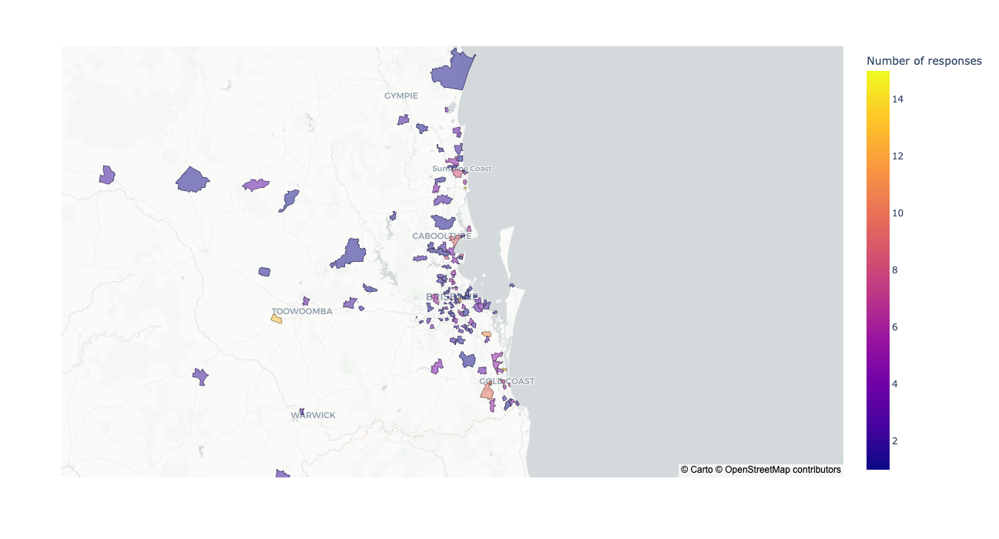

In [67]:
import plotly.express as px

fig = px.choropleth_mapbox(df_counts,
                           geojson=australia_geo_map,
                           locations='Suburb',
                           color='value',
                           mapbox_style="carto-positron",
                           hover_name="Postcode",
                           zoom=7,
                           center = {"lat": -27.2500, "lon": 153.0260},
                           opacity=0.5,
                           labels={'value':'Number of responses'},
                           featureidkey="properties.qld_loca_2",
                           height=700
                          )

fig.show()